# Learning Functions

Implementation of the simple function learning experiment carried out in section 4.1 of [*Neural Arithmetic Logic Units*](https://arxiv.org/abs/1808.00508).

Functions learned:

* Addition
* Subtraction
* Multiplication
* Division
* Sqrt
* Square

In [1]:
# Load environment
using Pkg
Pkg.activate("..")

"/Users/domluna/github/NeuralArithmetic/Project.toml"

In [2]:
using NeuralArithmetic
using Flux
using Plots
using DataFrames
import Distributions: Uniform

loaded


In [3]:
# number of training set examples
N = 500

500

The dataset of a function will contain `N` training examples, 100 validation examples (interpolation), and 100 testing examples (extrapolation).

The examples are sampled for a uniform distribution and then scaled to a larger range, the extrapolation range is larger than the interpolation range.

In [20]:
struct Dataset{F}
    f::F
    input_dim::Int
    train
    val # interpolation data
    test # extrapolation data
end

function gen_data_binary(f::F, n::Int, irange=5.0, erange=20.0) where {F}
    idist = Uniform(-irange, irange)
    edist = Uniform(-irange, erange)
    train_X = rand(idist, 2, n)
    train_y = f.(train_X[1, :], train_X[2, :])
    val_X = rand(idist, 2, 50)
    val_y = f.(val_X[1, :], val_X[2, :])
    test_X = rand(edist, 2, 100)
    test_y = f.(test_X[1, :], test_X[2, :])
    return Dataset(f, 2, (train_X, train_y), (val_X, val_y), (test_X, test_y))
end

function gen_data_unary(f::F, n::Int, irange=5.0, erange=20.0) where {F}
    if f == sqrt
        idist = Uniform(0, irange)
        edist = Uniform(0, erange)
    else
        idist = Uniform(-irange, irange)
        edist = Uniform(-erange, erange)
    end
    train_X = rand(idist, 1, n)
    train_y = f.(train_X[1, :])
    val_X = rand(idist, 1, 50)
    val_y = f.(val_X[1, :])
    test_X = rand(edist, 1, 100)
    test_y = f.(test_X[1, :])
    return Dataset(f, 1, (train_X, train_y), (val_X, val_y), (test_X, test_y))
end



gen_data_unary (generic function with 3 methods)

In [22]:
square = (x) -> ^(x, 2)

add_data = gen_data_binary(+, N)
sub_data = gen_data_binary(-, N)
div_data = gen_data_binary(/, N)
mul_data = gen_data_binary(*, N)
sqrt_data = gen_data_unary(sqrt, N)
square_data = gen_data_unary(square, N)

datasets = Dict(
    "add" => add_data,
    "sub" => sub_data,
    "div" => div_data,
    "mul" => mul_data,
    "sqrt" => sqrt_data,
    "square" => square_data,
)

Dict{String,Dataset} with 6 entries:
  "add"    => Dataset{typeof(+)}(+, 2, ([1.47291 2.745 … 0.931481 -0.704605; -2…
  "sub"    => Dataset{typeof(-)}(-, 2, ([-2.75197 -1.6121 … -1.46359 2.09365; -…
  "div"    => Dataset{typeof(/)}(/, 2, ([3.19371 -0.341795 … -0.300612 1.7453; …
  "mul"    => Dataset{typeof(*)}(*, 2, ([4.8922 -4.57769 … 0.645201 -3.48915; -…
  "sqrt"   => Dataset{typeof(sqrt)}(sqrt, 1, ([1.53588 3.46002 … 0.2074 4.84534…
  "square" => Dataset{##71#72}(##71#72(), 1, ([-1.97198 -4.08353 … 1.71026 -1.8…

Models we'll use in the experiments:

In [23]:
relu6(x) = min.(max.(x, 0.0), 6.0)

linear_model = (input_dim) -> Chain(Dense(input_dim, 2), Dense(2, 1))
relu6_model = (input_dim) -> Chain(Dense(input_dim, 2, relu6), Dense(2, 1))
nac_model = (input_dim) -> Chain(NAC(input_dim, 2), NAC(2, 1))
nalu_model = (input_dim) -> Chain(NALU(input_dim, 2), NALU(2, 1))

#79 (generic function with 1 method)

`train_model` trains the model are records interpolation and extrapolation losses.

`run_experiment` trains a separate model for each dataset and accumulates the results in `DataFrame`s.

In [24]:
loss(m) = (x, y) -> Flux.mse(m(x), y')

function train_model(model, opt, ds::Dataset, epochs::Int, print_interval::Int)
    lossf = loss(model)
    hist = Array{Float64}(undef, 2, epochs)
    for i in 1:epochs
        Flux.train!(lossf, [ds.train], opt)
        val_loss = Flux.data(lossf(ds.val...))
        test_loss = Flux.data(lossf(ds.test...))
        if print_interval != -1 && i % print_interval == 0
            @info "Iteration $i, validation loss = $val_loss"
        end
        hist[1, i] = val_loss
        hist[2, i] = test_loss
    end
    return hist
end

function run_experiment(modelf, datasets::Dict{String, Dataset}, epochs::Int=1000, print_interval::Int=-1)
    interpolation_df = DataFrame()
    extrapolation_df = DataFrame()
    for (name, ds) in datasets
        m = modelf(ds.input_dim)
        opt = ADAM(Flux.params(m))
        hist = train_model(m, opt, ds, epochs, print_interval)
        interpolation_df[Symbol(name)] = hist[1, :]
        extrapolation_df[Symbol(name)] = hist[2, :]
        @info "Done evaluation dataset $name"
    end
    return interpolation_df, extrapolation_df
end

run_experiment (generic function with 3 methods)

Let's run the experiments and plot results.

In [25]:
epochs = 10_000
# print_interval = 100

10000

┌ Info: Done evaluation dataset add
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[24]:28
┌ Info: Done evaluation dataset div
└ @ Main In[24]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[24]:28
┌ Info: Done evaluation dataset square
└ @ Main In[24]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 1.63011e-31), (:sub, 2.11821e-31), (:div, 60.8951), (:mul, 79.4554), (:sqrt, 0.0180383), (:square, 40.6805)]
└ @ Main In[26]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 5.60991e-30), (:sub, 1.73648e-30), (:div, 343.453), (:mul, 12120.6), (:sqrt, 2.26314), (:square, 35381.7)]
└ @ Main In[26]:10


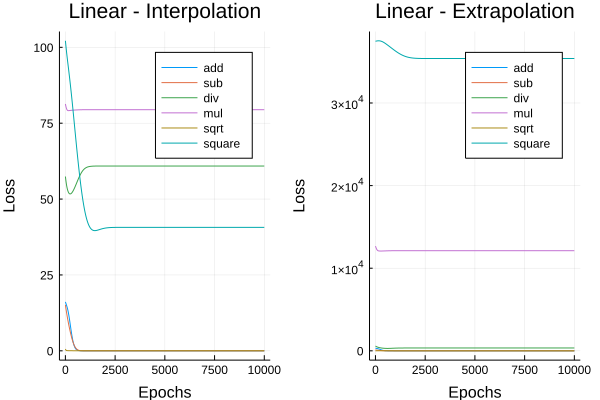

In [26]:
df1, df2 = run_experiment(linear_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="Linear - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="Linear - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

ReLU6 model.

┌ Info: Done evaluation dataset add
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[24]:28
┌ Info: Done evaluation dataset div
└ @ Main In[24]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[24]:28
┌ Info: Done evaluation dataset square
└ @ Main In[24]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 0.0217656), (:sub, 0.0194428), (:div, 66.0522), (:mul, 66.8026), (:sqrt, 0.354785), (:square, 27.0828)]
└ @ Main In[27]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 93.475), (:sub, 20.889), (:div, 283.183), (:mul, 12118.4), (:sqrt, 3.04022), (:square, 33499.5)]
└ @ Main In[27]:10


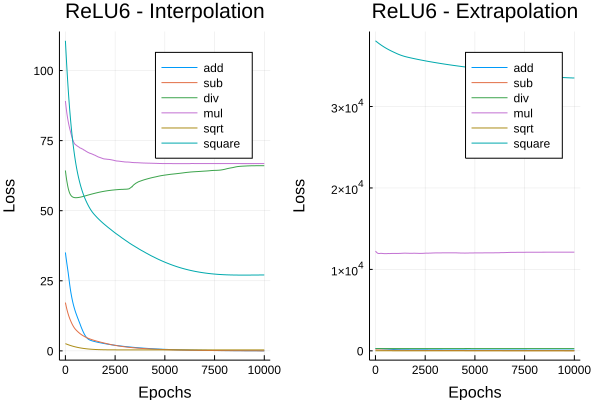

In [27]:
df1, df2 = run_experiment(relu6_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="ReLU6 - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="ReLU6 - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

NAC model.

┌ Info: Done evaluation dataset add
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[24]:28
┌ Info: Done evaluation dataset div
└ @ Main In[24]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[24]:28
┌ Info: Done evaluation dataset square
└ @ Main In[24]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 3.95309e-31), (:sub, 2.6062e-30), (:div, 60.8951), (:mul, 79.4554), (:sqrt, 0.0180383), (:square, 40.6805)]
└ @ Main In[28]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 3.97364e-30), (:sub, 4.37747e-29), (:div, 343.453), (:mul, 12120.6), (:sqrt, 2.26314), (:square, 35381.7)]
└ @ Main In[28]:10


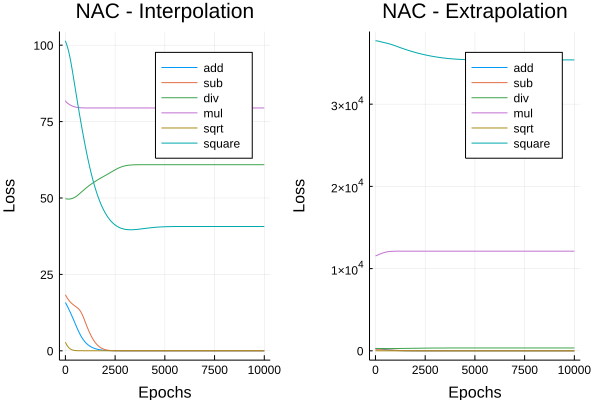

In [28]:
df1, df2 = run_experiment(nac_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="NAC - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="NAC - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

NALU model.

┌ Info: Done evaluation dataset add
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[24]:28
┌ Info: Done evaluation dataset div
└ @ Main In[24]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[24]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[24]:28
┌ Info: Done evaluation dataset square
└ @ Main In[24]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 0.00658156), (:sub, 0.0158493), (:div, 50.4927), (:mul, 40.6595), (:sqrt, 4.15759e-5), (:square, 0.526168)]
└ @ Main In[29]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 910.883), (:sub, 0.075545), (:div, 279.192), (:mul, 12043.3), (:sqrt, 2.00833), (:square, 20546.1)]
└ @ Main In[29]:10


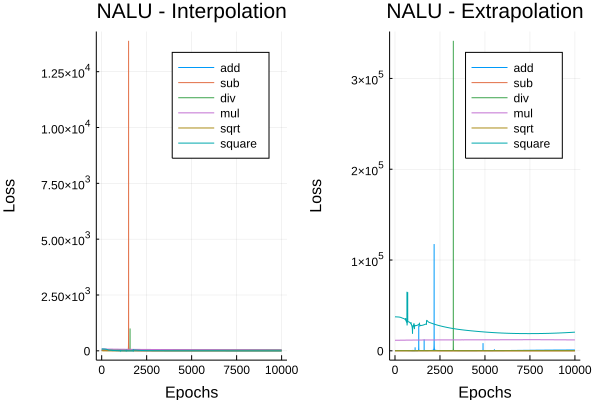

In [29]:
df1, df2 = run_experiment(nalu_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="NALU - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="NALU - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)